# Object Detection API Demo

<table align="left"><td>
  <a target="_blank"  href="https://colab.sandbox.google.com/github/tensorflow/models/blob/master/research/object_detection/colab_tutorials/object_detection_tutorial.ipynb">
    <img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab
  </a>
</td><td>
  <a target="_blank"  href="https://github.com/tensorflow/models/blob/master/research/object_detection/colab_tutorials/object_detection_tutorial.ipynb">
    <img width=32px src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />View source on GitHub</a>
</td></table>

Welcome to the [Object Detection API](https://github.com/tensorflow/models/tree/master/research/object_detection). This notebook will walk you step by step through the process of using a pre-trained model to detect objects in an image.

> **Important**: This tutorial is to help you through the first step towards using [Object Detection API](https://github.com/tensorflow/models/tree/master/research/object_detection) to build models. If you just just need an off the shelf model that does the job, see the [TFHub object detection example](https://colab.sandbox.google.com/github/tensorflow/hub/blob/master/examples/colab/object_detection.ipynb).

# Setup

Important: If you're running on a local machine, be sure to follow the [installation instructions](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2.md). This notebook includes only what's necessary to run in Colab.

### Install

In [1]:
%%bash
apt update 
apt install -y mc

Hit:1 http://archive.ubuntu.com/ubuntu focal InRelease
Get:2 http://archive.ubuntu.com/ubuntu focal-updates InRelease [114 kB]
Get:3 http://security.ubuntu.com/ubuntu focal-security InRelease [114 kB]
Get:4 http://archive.ubuntu.com/ubuntu focal-backports InRelease [108 kB]
Get:5 http://archive.ubuntu.com/ubuntu focal-updates/main amd64 Packages [2239 kB]
Get:6 http://security.ubuntu.com/ubuntu focal-security/universe amd64 Packages [873 kB]
Get:7 http://archive.ubuntu.com/ubuntu focal-updates/restricted amd64 Packages [1249 kB]
Get:8 http://archive.ubuntu.com/ubuntu focal-updates/multiverse amd64 Packages [30.3 kB]
Get:9 http://security.ubuntu.com/ubuntu focal-security/main amd64 Packages [1808 kB]
Get:10 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 Packages [1156 kB]
Get:11 http://security.ubuntu.com/ubuntu focal-security/restricted amd64 Packages [1169 kB]
Get:12 http://archive.ubuntu.com/ubuntu focal-backports/main amd64 Packages [51.2 kB]
Get:13 http://archive.ubu

Reading package lists...
Building dependency tree...
Reading state information...
The following additional packages will be installed:
  libglib2.0-0 libglib2.0-data libgpm2 libicu66 libslang2 libssh2-1 libxml2
  mc-data shared-mime-info tzdata unzip xdg-user-dirs
Suggested packages:
  gpm arj catdvi | texlive-binaries dbview djvulibre-bin epub-utils
  genisoimage gv imagemagick libaspell-dev links | w3m | lynx odt2txt
  poppler-utils python python-boto python-tz xpdf | pdf-viewer zip
The following NEW packages will be installed:
  libglib2.0-0 libglib2.0-data libgpm2 libicu66 libslang2 libssh2-1 libxml2 mc
  mc-data shared-mime-info tzdata unzip xdg-user-dirs
0 upgraded, 13 newly installed, 0 to remove and 52 not upgraded.
Need to get 13.7 MB of archives.
After this operation, 57.3 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal-updates/main amd64 libglib2.0-0 amd64 2.64.6-1~ubuntu20.04.4 [1287 kB]
Get:2 http://archive.ubuntu.com/ubuntu focal-upd

debconf: delaying package configuration, since apt-utils is not installed


Fetched 13.7 MB in 1s (9784 kB/s)
Selecting previously unselected package libglib2.0-0:amd64.
(Reading database ... 15420 files and directories currently installed.)
Preparing to unpack .../00-libglib2.0-0_2.64.6-1~ubuntu20.04.4_amd64.deb ...
Unpacking libglib2.0-0:amd64 (2.64.6-1~ubuntu20.04.4) ...
Selecting previously unselected package libglib2.0-data.
Preparing to unpack .../01-libglib2.0-data_2.64.6-1~ubuntu20.04.4_all.deb ...
Unpacking libglib2.0-data (2.64.6-1~ubuntu20.04.4) ...
Selecting previously unselected package tzdata.
Preparing to unpack .../02-tzdata_2022a-0ubuntu0.20.04_all.deb ...
Unpacking tzdata (2022a-0ubuntu0.20.04) ...
Selecting previously unselected package libicu66:amd64.
Preparing to unpack .../03-libicu66_66.1-2ubuntu2.1_amd64.deb ...
Unpacking libicu66:amd64 (66.1-2ubuntu2.1) ...
Selecting previously unselected package libslang2:amd64.
Preparing to unpack .../04-libslang2_2.3.2-4_amd64.deb ...
Unpacking libslang2:amd64 (2.3.2-4) ...
Selecting previously unse

In [2]:
!pip install -U --pre tensorflow=="2.*"
!pip install tf_slim


Requirement already up-to-date: tensorflow==2.* in /usr/local/lib/python3.8/dist-packages (2.9.0rc2)
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


Make sure you have `pycocotools` installed

In [3]:
!pip install pycocotools

     |████████████████████████████████| 106 kB 4.6 MB/s eta 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for pycocotools: filename=pycocotools-2.0.4-cp38-cp38-linux_x86_64.whl size=418761 sha256=971570031c84dad2dd2d5d03e9e4c64579901e17315a73e17b03e46d566a2a3e
  Stored in directory: /root/.cache/pip/wheels/dd/e2/43/3e93cd653b3346b3d702bb0509bc611189f95d60407bff1484
Successfully built pycocotools
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


Get `tensorflow/models` or `cd` to parent directory of the repository.

In [10]:
import os
import pathlib


if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

Compile protobufs and install the object_detection package

In [5]:
%%bash
apt install -y protobuf-compiler

Reading package lists...
Building dependency tree...
Reading state information...
The following additional packages will be installed:
  libprotobuf-dev libprotobuf-lite17 libprotobuf17 libprotoc17
The following NEW packages will be installed:
  libprotobuf-dev libprotobuf-lite17 libprotobuf17 libprotoc17
  protobuf-compiler
0 upgraded, 5 newly installed, 0 to remove and 0 not upgraded.
Need to get 2758 kB of archives.
After this operation, 16.9 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal/main amd64 libprotobuf-lite17 amd64 3.6.1.3-2ubuntu5 [132 kB]
Get:2 http://archive.ubuntu.com/ubuntu focal/main amd64 libprotobuf17 amd64 3.6.1.3-2ubuntu5 [798 kB]
Get:3 http://archive.ubuntu.com/ubuntu focal/main amd64 libprotoc17 amd64 3.6.1.3-2ubuntu5 [646 kB]
Get:4 http://archive.ubuntu.com/ubuntu focal/main amd64 libprotobuf-dev amd64 3.6.1.3-2ubuntu5 [1155 kB]
Get:5 http://archive.ubuntu.com/ubuntu focal/universe amd64 protobuf-compiler amd64 3.6.1.3-2u

debconf: delaying package configuration, since apt-utils is not installed


Fetched 2758 kB in 0s (5741 kB/s)
Selecting previously unselected package libprotobuf-lite17:amd64.
(Reading database ... 15420 files and directories currently installed.)
Preparing to unpack .../libprotobuf-lite17_3.6.1.3-2ubuntu5_amd64.deb ...
Unpacking libprotobuf-lite17:amd64 (3.6.1.3-2ubuntu5) ...
Selecting previously unselected package libprotobuf17:amd64.
Preparing to unpack .../libprotobuf17_3.6.1.3-2ubuntu5_amd64.deb ...
Unpacking libprotobuf17:amd64 (3.6.1.3-2ubuntu5) ...
Selecting previously unselected package libprotoc17:amd64.
Preparing to unpack .../libprotoc17_3.6.1.3-2ubuntu5_amd64.deb ...
Unpacking libprotoc17:amd64 (3.6.1.3-2ubuntu5) ...
Selecting previously unselected package libprotobuf-dev:amd64.
Preparing to unpack .../libprotobuf-dev_3.6.1.3-2ubuntu5_amd64.deb ...
Unpacking libprotobuf-dev:amd64 (3.6.1.3-2ubuntu5) ...
Selecting previously unselected package protobuf-compiler.
Preparing to unpack .../protobuf-compiler_3.6.1.3-2ubuntu5_amd64.deb ...
Unpacking proto

In [6]:
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.

In [7]:
%%bash 
cd models/research
cp object_detection/packages/tf2/setup.py .
#pip install . --upgrade
python -m pip install --use-feature=2020-resolver .
#pip install .

Processing /tf/notebook/models/research
  Using cached Cython-0.29.28-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.manylinux_2_24_x86_64.whl (1.9 MB)


  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1692781 sha256=a95ffd2413c57f90db1141a4939d3762e3af145655ccaf8eac1acc13305bf6f9
  Stored in directory: /tmp/pip-ephem-wheel-cache-gpjul6yk/wheels/96/3b/d0/d66f5cd38152b2c7089dec3325147fe77e18b7ac39b1516c10
  Created wheel for avro-python3: filename=avro_python3-1.10.2-py3-none-any.whl size=44009 sha256=2199736777ed1748912ba3036d83ea012fb836f0cf591d7a525a1f03903cc6bd
  Stored in directory: /root/.cache/pip/wheels/bb/73/e9/d273421f5723c4bf544dcf9eb097bda94421ef8d3252699f0a


  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78545 sha256=9524081425b66839e6db7638c63c79167ed1c8c75710710b7c6cde5c47a6a89a
  Stored in directory: /root/.cache/pip/wheels/07/35/78/e9004fa30578734db7f10e7a211605f3f0778d2bdde38a239d
  Created wheel for crcmod: filename=crcmod-1.7-cp38-cp38-linux_x86_64.whl size=35987 sha256=1a22a4b34d07595b2658b92bd200134f8c551686ada463e88bc1d590b072a109
  Stored in directory: /root/.cache/pip/wheels/ca/5a/02/f3acf982a026f3319fb3e798a8dca2d48fafee7761788562e9
  Created wheel for seqeval: filename=seqeval-1.2.2-py3-none-any.whl size=16182 sha256=87d64fd28f51e3e5da8a7821fec32bba10e4512a80d13b6b762824d85d5bdff9
  Stored in directory: /root/.cache/pip/wheels/ad/5c/ba/05fa33fa5855777b7d686e843ec07452f22a66a138e290e732
  Created wheel for kaggle: filename=kaggle-1.5.12-py3-none-any.whl size=73052 sha256=72aadef18a5818ae297a1201b95934723e5f3b835427934fbf868db588e6f2c1
  Stored in directory: /root/.cache/pip/wheels/29/da/11/144cc25aebdaeb

ERROR: After October 2020 you may experience errors when installing or updating packages. This is because pip will change the way that it resolves dependency conflicts.

We recommend you use --use-feature=2020-resolver to test your packages with the new resolver before it becomes the default.

tensorflow 2.8.0 requires keras<2.9,>=2.8.0rc0, but you'll have keras 2.9.0rc2 which is incompatible.
tensorflow-cpu 2.7.1 requires keras<2.8,>=2.7.0rc0, but you'll have keras 2.9.0rc2 which is incompatible.
tensorflow-cpu 2.7.1 requires tensorflow-estimator<2.8,~=2.7.0rc0, but you'll have tensorflow-estimator 2.9.0rc0 which is incompatible.
httplib2 0.19.1 requires pyparsing<3,>=2.4.2, but you'll have pyparsing 3.0.7 which is incompatible.


You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


Processing /tf/notebook/models/research


  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.0.7
    Uninstalling pyparsing-3.0.7:
      Successfully uninstalled pyparsing-3.0.7
  Attempting uninstall: keras
    Found existing installation: keras 2.9.0rc2


    Uninstalling keras-2.9.0rc2:
      Successfully uninstalled keras-2.9.0rc2


ERROR: tensorflow-cpu 2.7.1 requires keras<2.8,>=2.7.0rc0, but you'll have keras 2.8.0 which is incompatible.
tensorflow-cpu 2.7.1 requires tensorflow-estimator<2.8,~=2.7.0rc0, but you'll have tensorflow-estimator 2.9.0rc0 which is incompatible.


You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.


In [19]:
%%bash
echo fixing above.
#python -m pip uninstall -y tensorflow keras pyparsing

fixing above.


In [18]:
%%bash
python -m pip install tensorflow keras pyparsing

You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.
You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.


Found existing installation: keras 2.8.0
Uninstalling keras-2.8.0:
  Successfully uninstalled keras-2.8.0


  Using cached tensorflow-2.8.0-cp38-cp38-manylinux2010_x86_64.whl (497.6 MB)
  Using cached keras-2.8.0-py2.py3-none-any.whl (1.4 MB)
  Using cached pyparsing-3.0.9-py3-none-any.whl (98 kB)


ERROR: After October 2020 you may experience errors when installing or updating packages. This is because pip will change the way that it resolves dependency conflicts.

We recommend you use --use-feature=2020-resolver to test your packages with the new resolver before it becomes the default.

tensorflow-cpu 2.7.1 requires keras<2.8,>=2.7.0rc0, but you'll have keras 2.8.0 which is incompatible.
tensorflow-cpu 2.7.1 requires tensorflow-estimator<2.8,~=2.7.0rc0, but you'll have tensorflow-estimator 2.9.0rc0 which is incompatible.
httplib2 0.19.1 requires pyparsing<3,>=2.4.2, but you'll have pyparsing 3.0.9 which is incompatible.


You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.


In [1]:
%%bash
pip install pyparsing==2.4.2
pip install httplib2==0.20.2

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


  Attempting uninstall: httplib2
    Found existing installation: httplib2 0.19.1
    Uninstalling httplib2-0.19.1:
      Successfully uninstalled httplib2-0.19.1


ERROR: After October 2020 you may experience errors when installing or updating packages. This is because pip will change the way that it resolves dependency conflicts.

We recommend you use --use-feature=2020-resolver to test your packages with the new resolver before it becomes the default.

apache-beam 2.38.0 requires httplib2<0.20.0,>=0.8, but you'll have httplib2 0.20.2 which is incompatible.


You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


### Imports

In [2]:
%%bash
pwd
pip list

/tf/notebook
Package                       Version
----------------------------- -------------------
absl-py                       1.0.0
apache-beam                   2.38.0
argon2-cffi                   21.3.0
argon2-cffi-bindings          21.2.0
asttokens                     2.0.5
astunparse                    1.6.3
attrs                         21.4.0
avro-python3                  1.10.2
backcall                      0.2.0
black                         22.1.0
bleach                        4.1.0
cachetools                    5.0.0
certifi                       2021.10.8
cffi                          1.15.0
charset-normalizer            2.0.11
click                         8.0.3
cloudpickle                   2.0.0
colorama                      0.4.4
contextlib2                   21.6.0
crcmod                        1.7
cycler                        0.11.0
Cython                        0.29.28
debugpy                       1.5.1
decorator                     5.1.1
defusedxml           

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


In [3]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

Import the object detection module.

In [4]:
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

Patches:

In [5]:
# patch tf1 into `utils.ops`
utils_ops.tf = tf.compat.v1

# Patch the location of gfile
tf.gfile = tf.io.gfile

# Model preparation 

## Variables

Any model exported using the `export_inference_graph.py` tool can be loaded here simply by changing the path.

By default we use an "SSD with Mobilenet" model here. See the [detection model zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md) for a list of other models that can be run out-of-the-box with varying speeds and accuracies.

## Loader

In [9]:
def load_model(model_name):
  base_url = 'http://download.tensorflow.org/models/object_detection/'
  model_file = model_name + '.tar.gz'
  model_dir = tf.keras.utils.get_file(
    fname=model_name, 
    origin=base_url + model_file,
    untar=True)

  model_dir = pathlib.Path(model_dir)/"saved_model"

  model = tf.saved_model.load(str(model_dir))

  return model

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

In [7]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

For the sake of simplicity we will test on 2 images:

In [11]:
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
import pathlib
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('models/research/object_detection/test_images')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[PosixPath('models/research/object_detection/test_images/image1.jpg'),
 PosixPath('models/research/object_detection/test_images/image2.jpg'),
 PosixPath('models/research/object_detection/test_images/image3.jpg')]

# Detection

Load an object detection model:

In [12]:
model_name = 'ssd_mobilenet_v1_coco_2017_11_17'
detection_model = load_model(model_name)

76546048/76534733 [==============================] - 7s 0us/step
INFO:tensorflow:Saver not created because there are no variables in the graph to restore


Check the model's input signature, it expects a batch of 3-color images of type uint8:

In [13]:
print(detection_model.signatures['serving_default'].inputs)

[<tf.Tensor 'image_tensor:0' shape=(None, None, None, 3) dtype=uint8>]


And returns several outputs:

In [14]:
detection_model.signatures['serving_default'].output_dtypes

{'num_detections': tf.float32,
 'detection_boxes': tf.float32,
 'detection_scores': tf.float32,
 'detection_classes': tf.float32}

In [15]:
detection_model.signatures['serving_default'].output_shapes

{'num_detections': TensorShape([None]),
 'detection_boxes': TensorShape([None, 100, 4]),
 'detection_scores': TensorShape([None, 100]),
 'detection_classes': TensorShape([None, 100])}

Add a wrapper function to call the model, and cleanup the outputs:

In [16]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

Run it on each test image and show the results:

In [17]:
def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))

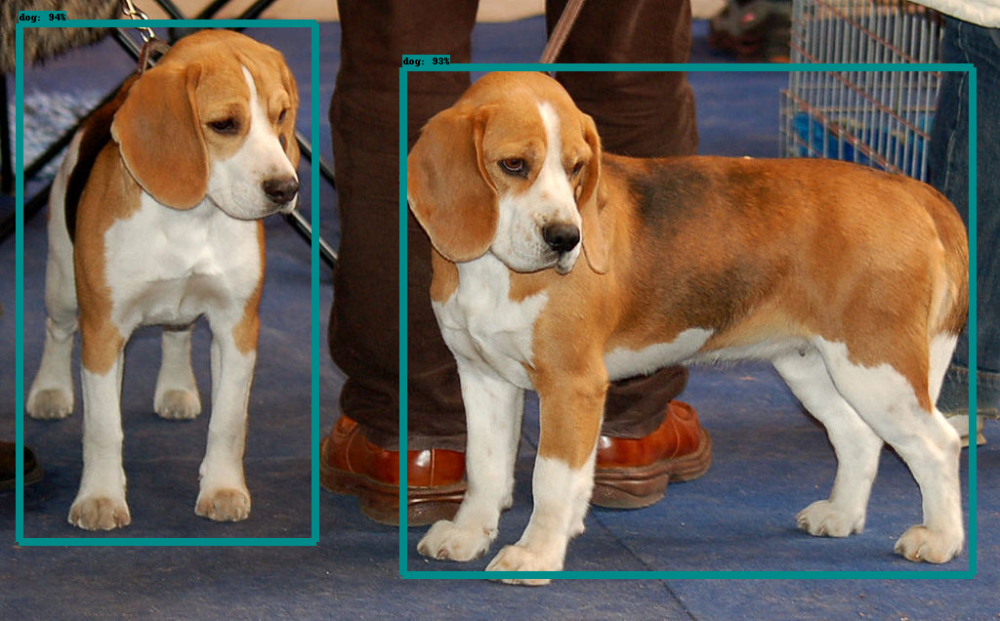

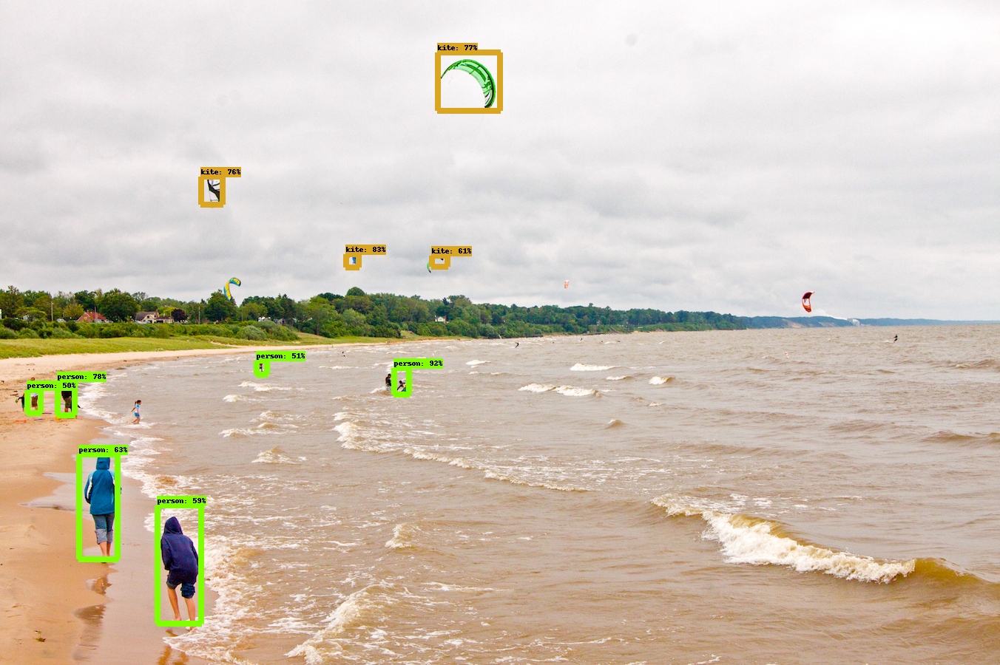

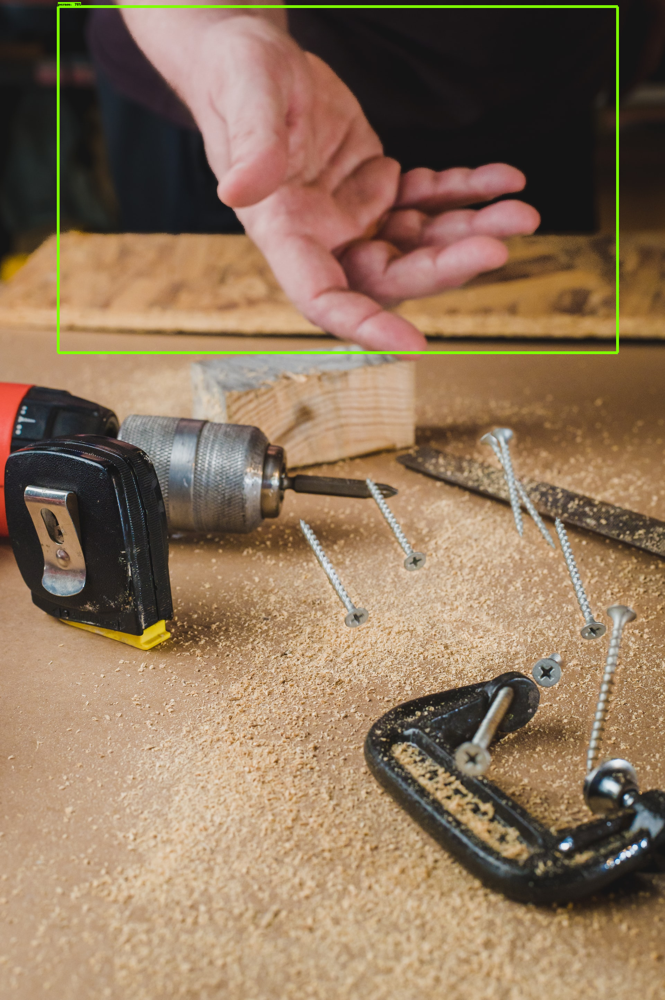

In [18]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(detection_model, image_path)


## Instance Segmentation

In [19]:
model_name = "mask_rcnn_inception_resnet_v2_atrous_coco_2018_01_28"
masking_model = load_model(model_name)

727400448/727390102 [==============================] - 63s 0us/step
INFO:tensorflow:Saver not created because there are no variables in the graph to restore


The instance segmentation model includes a `detection_masks` output:

In [21]:
# was.. masking_model.output_shapes
masking_model.signatures['serving_default'].output_shapes

{'detection_scores': TensorShape([None, 100]),
 'detection_boxes': TensorShape([None, 100, 4]),
 'detection_classes': TensorShape([None, 100]),
 'num_detections': TensorShape([None]),
 'detection_masks': TensorShape([None, None, 33, 33])}

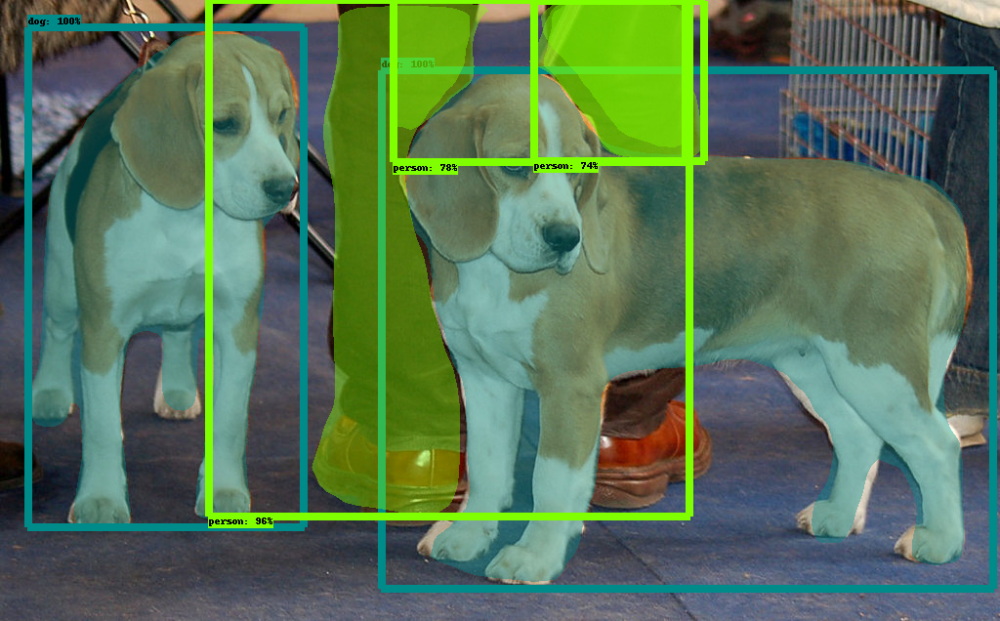

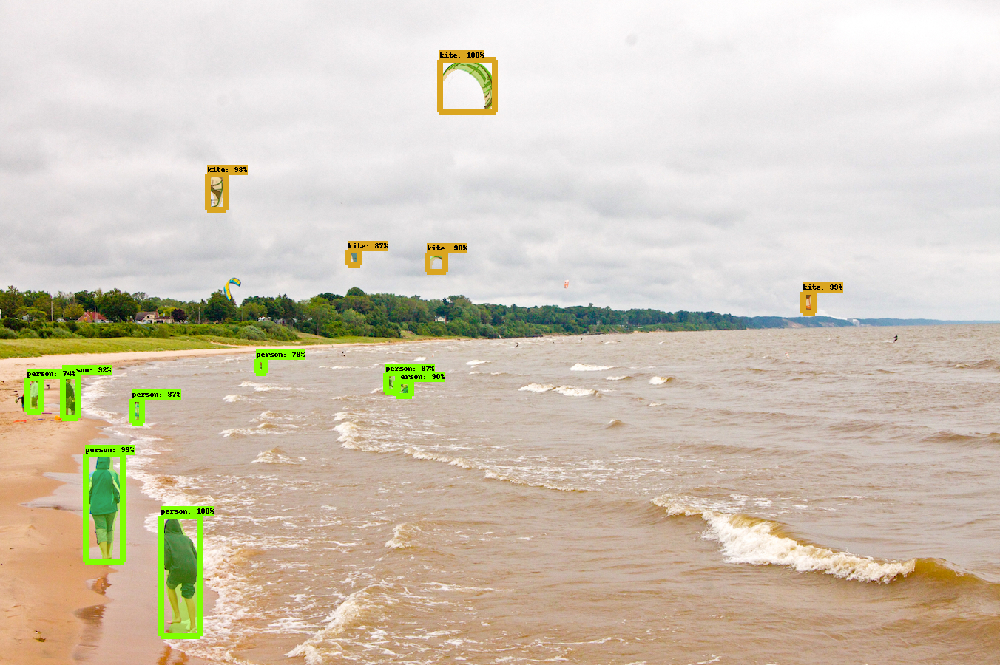

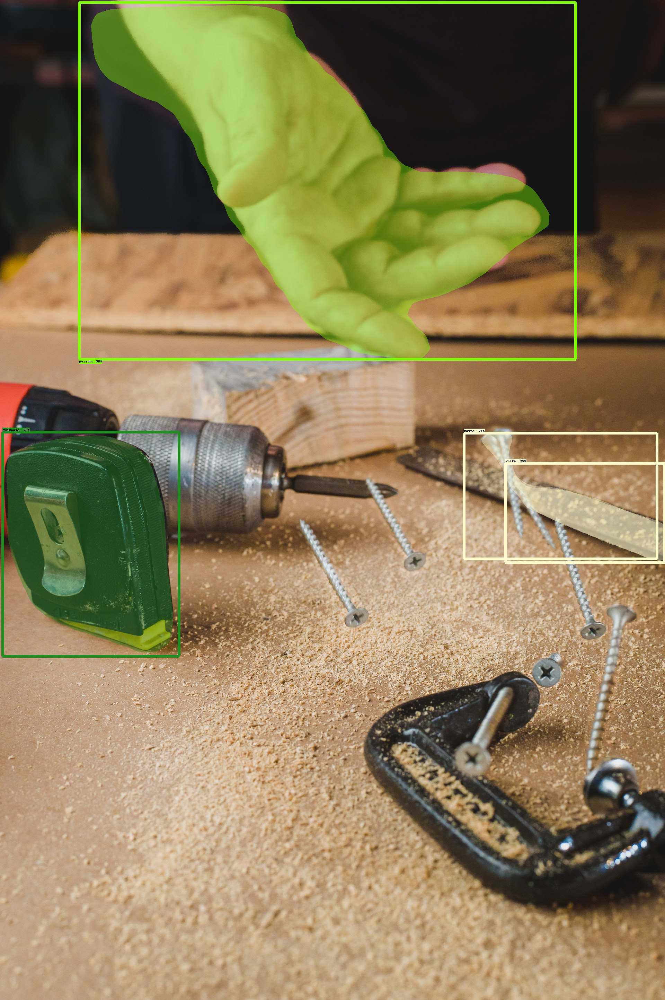

In [22]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(masking_model, image_path)